# DCGAN implementation and Control Model (CM) training

After having a good grasp of the dataset, and defining the format of MRIs by preprocessing  and visualizing final images ready for training, we can start working on the actual GAN training process.

We are going to use a DCGAN architecture ([UNSUPERVISED REPRESENTATION LEARNING
WITH DEEP CONVOLUTIONAL
GENERATIVE ADVERSARIAL NETWORKS](https://arxiv.org/pdf/1511.06434.pdf)). In this paper, in page 3, we will find some useful guidelines for defining the architecture:

> Architecture guidelines for stable Deep Convolutional GANs:
>    * Replace any pooling layers with strided convolutions (discriminator) and fractional-strided convolutions (generator).
>    * Use batchnorm in both the generator and the discriminator.
>    * Remove fully connected hidden layers for deeper architectures.
>    * Use ReLU activation in generator for all layers except for the output, which uses Tanh.
>    * Use LeakyReLU activation in the discriminator for all layers.

From a highlevel perspective, the architecture would look something like this:

![DCGAN paper implementation using PyTorch to generate faces](assets/dcgan_arch.png)

In particular, we will base this DCGAN implementation on Udacity's Project __Face Generation__.

Lets start defining dependencies, and loading the dataset applying transformers defined in the previous notebook.

In [1]:
import os
import time
import glob
import torch
import torchvision.datasets as datasets
import torchvision.transforms as transforms
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import pickle as pkl
import numpy as np
from PIL import Image, ImageOps
import matplotlib
from matplotlib import pyplot as plt
from matplotlib.pyplot import imshow
from mpl_toolkits.axes_grid1 import ImageGrid

In [2]:
# Note: we know these are gray scale images, so we should directly show it like that,
# matplotlib would show images in rgb if we don't set it to gray scale
    
def show_img_list(imgs_list, n_rows, n_cols, width, height):
    px = 10 / plt.rcParams['figure.dpi']
    fig = plt.figure(figsize=(width*px, height*px))
    grid = ImageGrid(fig, (1,1,1,1),
        nrows_ncols=(n_rows, n_cols),
        axes_pad=0.1,
    )

    for ax, _img in zip(grid, imgs_list):
        img = _img
        if isinstance(img, list):
            # show legend if possible
            img = _img[0]
            legend = _img[1]
            ax.text(4, 10, legend, fontsize=20, bbox={'facecolor': 'white', 'pad': 10})
        npimg = img.permute(1,2,0).numpy()
        ax.imshow(npimg, cmap='gray')

    plt.show()

def get_data_loader_set(data_loader, len_set):
    dataiter = iter(data_loader)
    images = []
    for n in np.arange(len_set):
        img, _ = dataiter.next()
        # get first image from batch
        images.append(img[0])
    return images

In [3]:
def get_dataset_dataloader(batch_size, image_size, dataset_path):
    
    transform = transforms.Compose([
        transforms.Grayscale(num_output_channels=1),
        transforms.CenterCrop(176),
        transforms.Resize(size=(image_size, image_size)),
        transforms.ToTensor()
    ])

    dataset = datasets.ImageFolder(dataset_path, transform)

    data_loader = torch.utils.data.DataLoader(
        dataset=dataset,
        batch_size=batch_size,
        shuffle=True,
        num_workers=0,
    )
    
    return dataset, data_loader

In [4]:
dataset_path = 'data/alzheimers_mri_dataset/train'
# using an odd batch size, if we use 64 the last batch will have only 1 img and will error out,
# instead if we use 63, the last batch will have 41 images which is ok
batch_size = 63 
img_size = 128
demented_dataset, demented_train_loader = get_dataset_dataloader(batch_size, img_size, dataset_path)
print(f'dataset size: {len(demented_dataset)}')

dataset size: 2561


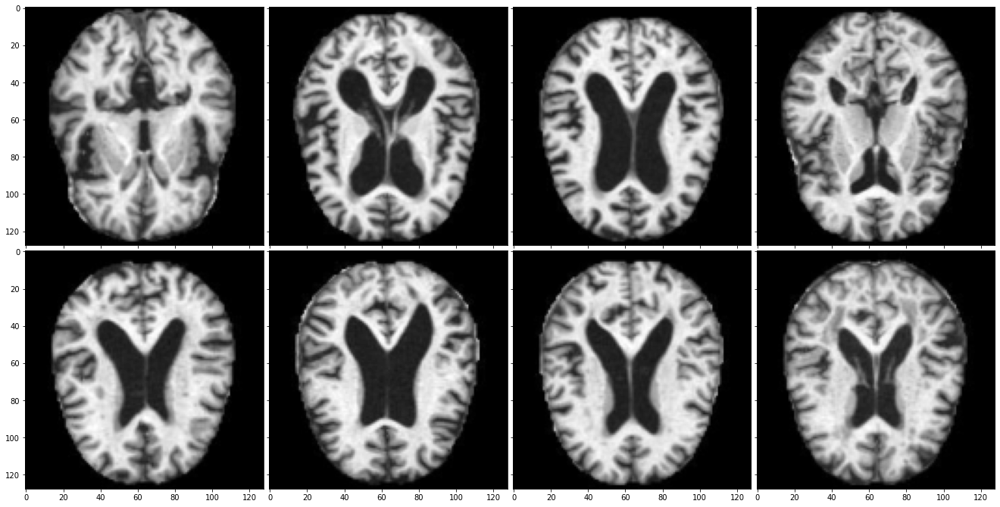

In [5]:
sample_images = get_data_loader_set(demented_train_loader, 8)
show_img_list(sample_images, 2, 4, img_size, img_size)

We can see images were loaded correctly.

In the DCGAN paper architecture guidlines they mention that Hyperbolic Tangent (Tanh) is used in the output layer of the generator, and the output of Tanh will contain pixel values in a range from -1 to 1, so we need to preprocess pixel values and scale it to be between -1 to 1, instead of 0 to 1.

In [6]:
def scale(x, feature_range=(-1, 1)):
    min_val, max_val = feature_range
    x = x * (max_val - min_val) + min_val
    return x

In [7]:
img = sample_images[0]
scaled_img = scale(img)

print(img.shape)
print('Min: ', scaled_img.min())
print('Max: ', scaled_img.max())

torch.Size([1, 128, 128])
Min:  tensor(-1.)
Max:  tensor(0.9294)


### DCGAN Control Model Definition

The main goal here will be to define the base GAN model used in the ensemble, and as we know, a GAN is divided into two parts, a Discriminator and a Generator.

Lets define first some helper functions needed for defining the model.

In [8]:
def conv(in_channels, out_channels, kernel_size, stride=2, padding=1, batch_norm=True):
    # creates a sequential container with a convolutional layer,
    # and a batch normalization layer if required
    layers = []
    
    conv_layer = nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding, bias=False) 
    layers.append(conv_layer)

    if batch_norm:
        layers.append(nn.BatchNorm2d(out_channels))

    return nn.Sequential(*layers)


def deconv(in_channels, out_channels, kernel_size, stride=2, padding=1, batch_norm=True):
    # creates a sequential container with a transposed convolutional layer, or deconvolution,
    # and a batch normalization layer if required
    layers = []

    transpose_conv_layer = nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding, bias=False)
    layers.append(transpose_conv_layer)

    if batch_norm:
        layers.append(nn.BatchNorm2d(out_channels))
        
    return nn.Sequential(*layers)

### Discriminator

This is a convolutional classifier, receiving an input of a 128x128x1 image, and returning and output a single value to determine if the image is real or fake.

In [9]:
class Discriminator(nn.Module):

    def __init__(self, conv_dim=128):
        """
        Init Discriminator Module
        :param conv_dim: depth of the first convolutional layer
        """
        super(Discriminator, self).__init__()
        
        self.conv_dim = conv_dim
        
        # 128x128x1
        # no need for batchnorm in first layer according to DCGAN paper
        # "...not applying batchnorm to the generator output layer and the discriminator input layer."
        self.conv1 = conv(1, self.conv_dim, kernel_size=4, stride=2, padding=1, batch_norm=False)
        # 64x64x128
        self.conv2 = conv(self.conv_dim, self.conv_dim*2, kernel_size=4, stride=2, padding=1, batch_norm=True)
        # 32x32x256
        self.conv3 = conv(self.conv_dim*2, self.conv_dim*4, kernel_size=4, stride=2, padding=1, batch_norm=True)
        # 16x16x512
        self.conv4 = conv(self.conv_dim*4, self.conv_dim*8, kernel_size=4, stride=2, padding=1, batch_norm=True)
        # 8x8x1024
        
        self.fc = nn.Linear(8*8*8*self.conv_dim, 1)
        
    def forward(self, x):
        """
        Forward propagation of the neural network
        :param x: The input to the neural network     
        :return: Discriminator logits; the output of the neural network
        """
        
        # conv layers
        x = F.leaky_relu(self.conv1(x), 0.2)
        x = F.leaky_relu(self.conv2(x), 0.2)
        x = F.leaky_relu(self.conv3(x), 0.2)
        x = F.leaky_relu(self.conv4(x), 0.2)
        
        # fully connected layer
        x = x.view(-1, 8*8*8*self.conv_dim)
        output_logits = self.fc(x)
        
        return output_logits

### Generator

This will take a random input, a vector of some length, and upscale it to be an image with the same shape as our MRIs, the output should be a 128x128x1 image.

In [10]:
class Generator(nn.Module):
    
    def __init__(self, z_size, conv_dim=128):
        """
        Init Generator Module
        :param z_size: length of the input latent vector, z
        :param conv_dim: depth of the inputs to the *last* transpose convolutional layer
        """
        super(Generator, self).__init__()

        self.z_size = z_size
        self.conv_dim = conv_dim
        
        self.fc = nn.Linear(self.z_size, 8*8*8*self.conv_dim)
        
        # 4x4x1024
        self.t_conv1 = deconv(self.conv_dim*8, self.conv_dim*4, kernel_size=4, stride=2, padding=1, batch_norm=True)
        # 16x16x512
        self.t_conv2 = deconv(self.conv_dim*4, self.conv_dim*2, kernel_size=4, stride=2, padding=1, batch_norm=True)
        # 32x32x256
        self.t_conv3 = deconv(self.conv_dim*2, self.conv_dim, kernel_size=4, stride=2, padding=1, batch_norm=True)
        # 64x64x128
        # no need for batchnorm in last layer according to DCGAN paper
        # "...not applying batchnorm to the generator output layer and the discriminator input layer."
        self.t_conv4 = deconv(self.conv_dim, 1, kernel_size=4, stride=2, padding=1, batch_norm=False)
        # 128x128x1

    def forward(self, x):
        """
        Forward propagation of the neural network
        :param x: The input to the neural network     
        :return: A 128x128x1 Tensor image as output
        """
        
        # fully connected layer
        x = self.fc(x)
        # reshape to target tensor dimensionality
        x = x.view(-1, self.conv_dim*8, 8, 8)
        
        # transpose convolutional layers
        x = F.relu(self.t_conv1(x))
        x = F.relu(self.t_conv2(x))
        x = F.relu(self.t_conv3(x))
        # finally apply hiperbolic tangent
        x = torch.tanh(self.t_conv4(x))
        
        return x

## Weights of the network

According to DCGAN paper:

> All weights were initialized from a zero-centered Normal distribution with standard deviation 0.02.

In [11]:
def weights_init_normal(m):
    """
    Applies initial weights to certain layers in a model
    The weights are taken from a normal distribution 
    with mean = 0, std dev = 0.02.
    :param m: A module or layer in a network    
    """
    classname = m.__class__.__name__
    
    # only conv/conv_trans/bathnorm and linear layers
    if type(m) == nn.Conv2d or type(m) == nn.ConvTranspose2d or type(m) == nn.Linear:
        nn.init.normal_(m.weight.data, mean=0.0, std=0.02)
    elif type(m) == nn.BatchNorm2d:
        # based on https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html#weight-initialization
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0.0)

Lets define a helper function to create the entire network, and the hyperparameters for it.

In [12]:
def build_network(d_conv_dim, g_conv_dim, z_size):
    # define discriminator and generator
    D = Discriminator(d_conv_dim)
    G = Generator(z_size=z_size, conv_dim=g_conv_dim)

    # initialize model weights
    D.apply(weights_init_normal)
    G.apply(weights_init_normal)
    
    return D, G

In [13]:
# Hyperparams
d_conv_dim = 128
g_conv_dim = 128
z_size = 200

D, G = build_network(d_conv_dim, g_conv_dim, z_size)

print(D)
print()
print(G)

Discriminator(
  (conv1): Sequential(
    (0): Conv2d(1, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  )
  (conv2): Sequential(
    (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv3): Sequential(
    (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv4): Sequential(
    (0): Conv2d(512, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (fc): Linear(in_features=65536, out_features=1, bias=True)
)

Generator(
  (fc): Linear(in_features=200, out_features=65536, bias=True)
  (t_conv1): Sequential(
    (0): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), b

In [14]:
train_on_gpu = torch.cuda.is_available()
if not train_on_gpu:
    print('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Training on GPU!')

Training on GPU!


## Discriminator and Generator Losses


### Discriminator Losses

The total loss is the sum of the losses for real and fake images, `d_loss = d_real_loss + d_fake_loss`. 

### Generator Loss

Similarly, only with flipped labels. The generator's goal is to get the discriminator to *think* its generated images are *real*.

In [15]:
def real_loss(D_out):
    '''Calculates how close discriminator outputs are to being real.
       param, D_out: discriminator logits
       return: real loss'''
    
    # get batch size from output
    batch_size = D_out.size(0)
    
    # init target labels of 1s and send to gpu
    labels = torch.ones(batch_size)
    if train_on_gpu:
        labels = labels.cuda()
    
    # define loss fn, and get difference between output and target labels
    criterion = nn.BCEWithLogitsLoss()
    loss = criterion(D_out.squeeze(), labels)
    return loss

def fake_loss(D_out):
    '''Calculates how close discriminator outputs are to being fake.
       param, D_out: discriminator logits
       return: fake loss'''
    
    # get batch size from output
    batch_size = D_out.size(0)
    
    # init target labels of 0s and send to gpu
    labels = torch.zeros(batch_size)
    if train_on_gpu:
        labels = labels.cuda()
    
    # define loss fn, and calculate difference between output and target labels
    criterion = nn.BCEWithLogitsLoss()
    loss = criterion(D_out.squeeze(), labels)
    return loss

## Optimizers

We will use Adam optimizers, using values suggested in DCGAN paper:

> Additionally, we found leaving the momentum term  1 at the suggested value of 0.9 resulted in training oscillation and instability while reducing it to 0.5 helped
stabilize training.

In [16]:
# default hyperparams values according to DCGAN paper
# learning_rate = 0.0002
# beta1 = 0.5
# beta2 = 0.999
# but adding a small variation in learning rate,
#   changing it made the generator and discriminator losses stabilised a bit more quickly
learning_rate = 0.0001 
beta1 = 0.5
beta2 = 0.999

# Create optimizers for the discriminator D and generator G
d_optimizer = optim.Adam(D.parameters(), learning_rate, [beta1, beta2])
g_optimizer = optim.Adam(G.parameters(), learning_rate, [beta1, beta2])

samples_path = 'cm/train_samples.pkl'

In [17]:
# clean models folder
!rm -rf cm/models
!mkdir -p cm/models

## Training

Training will involve alternating between training the discriminator and the generator. Also, we will save snapshoots of losses and images from each epoch, in order to check the progress of the generator.

In [18]:
def train(train_loader, D, G, n_epochs, print_every=50):
    '''Trains adversarial networks for some number of epochs,
       generate some samples for checking progress, and save snapshoot of network.
       param, train_loader: loaded data
       param, D: the discriminator network
       param, G: the generator network
       param, n_epochs: number of epochs to train
       param, print_every: when to print and record the models' losses
       return: D and G losses'''
    start_time = time.time()
    print(f' >>> training started')
    
    # move models to GPU
    if train_on_gpu:
        D.cuda()
        G.cuda()

    # keep track of loss and generated "fake" samples
    samples = []
    losses = []

    # Get some fixed data for sampling. These are images that are held
    # constant throughout training, and allow us to inspect the model's performance
    sample_size = 16
    fixed_z = np.random.uniform(-1, 1, size=(sample_size, z_size))
    fixed_z = torch.from_numpy(fixed_z).float()
    # move z to GPU if available
    if train_on_gpu:
        fixed_z = fixed_z.cuda()

    # epoch training loop
    for epoch in range(n_epochs):

        # batch training loop
        for batch_i, (real_images, _) in enumerate(train_loader):

            batch_size = real_images.size(0)
            real_images = scale(real_images)
            if train_on_gpu:
                real_images = real_images.cuda()
            
            # 1. Train the discriminator on real and fake images
            
            # init discriminator weights
            d_optimizer.zero_grad()
            
            # get real loss
            D_real_output_logits = D(real_images)  ### logits real for disc
            d_real_loss = real_loss(D_real_output_logits)
            
            # init z noise vector
            z = np.random.uniform(-1, 1, size=(batch_size, z_size))
            z = torch.from_numpy(z).float()
            if train_on_gpu:
                z = z.cuda()

            # generate fake images
            fake_images = G(z)
            
            # get fake loss
            D_fake_disc_output_logits = D(fake_images) ### logits fake for disc
            d_fake_loss = fake_loss(D_fake_disc_output_logits)
            
            # total loss
            d_loss = d_real_loss + d_fake_loss
            # backpropagation and optimization on discriminator
            d_loss.backward()
            d_optimizer.step()

            # 2. Train the generator with adversarial loss
            
            # init weights for generator
            g_optimizer.zero_grad()
            
            # init z noise vector
            z = np.random.uniform(-1, 1, size=(batch_size, z_size))
            z = torch.from_numpy(z).float()
            if train_on_gpu:
                z = z.cuda()
            # generate fake images
            fake_images = G(z)
            
            D_fake_gen_output_logits = D(fake_images)  # logits fake for generator
            g_loss = real_loss(D_fake_gen_output_logits)
            # backpropagation and optimization on generator
            g_loss.backward()
            g_optimizer.step()

            # Print some loss stats
            if batch_i % print_every == 0:
                # append discriminator loss and generator loss
                losses.append((d_loss.item(), g_loss.item()))
                # print discriminator and generator loss
                print('Epoch [{:5d}/{:5d}] | d_loss: {:6.4f} | g_loss: {:6.4f}'.format(
                        epoch+1, n_epochs, d_loss.item(), g_loss.item()))

        # generate and save sample, fake images
        G.eval() # for generating samples
        samples_z = G(fixed_z)
        samples.append(samples_z)
        G.train() # back to training mode
        
        # taking a sanpshoot at epoch 35
        # which is going to be used in the ensemble as a point of reference
        if epoch+1 == 35:
            model_path = 'cm/models/cm35'
            print(f' *** saving model {epoch+1}: {model_path}')
            torch.save(G.state_dict(), model_path)

    # save training generator samples
    with open(samples_path, 'wb') as f:
        pkl.dump(samples, f)
        
    elapsed_time = time.time() - start_time
    elapsed_time_hrs = elapsed_time / 60
    print(' >>> training finished %ssec %smin' % (elapsed_time, elapsed_time_hrs))

    return losses

In [19]:
# set number of epochs 
n_epochs = 65
print_every = 100

losses = train(demented_train_loader, D, G, n_epochs=n_epochs, print_every=print_every)

 >>> training started
Epoch [    1/   65] | d_loss: 3.0080 | g_loss: 4.6243
Epoch [    2/   65] | d_loss: 0.7443 | g_loss: 46.3387
Epoch [    3/   65] | d_loss: 10.1622 | g_loss: 0.0008
Epoch [    4/   65] | d_loss: 6.9371 | g_loss: 4.7007
Epoch [    5/   65] | d_loss: 0.8140 | g_loss: 15.6450
Epoch [    6/   65] | d_loss: 0.9512 | g_loss: 2.4619
Epoch [    7/   65] | d_loss: 0.1398 | g_loss: 5.7915
Epoch [    8/   65] | d_loss: 1.7604 | g_loss: 2.4590
Epoch [    9/   65] | d_loss: 0.3924 | g_loss: 23.6431
Epoch [   10/   65] | d_loss: 0.0614 | g_loss: 7.7336
Epoch [   11/   65] | d_loss: 5.4211 | g_loss: 11.5663
Epoch [   12/   65] | d_loss: 0.1822 | g_loss: 7.6493
Epoch [   13/   65] | d_loss: 0.1278 | g_loss: 9.6942
Epoch [   14/   65] | d_loss: 0.2190 | g_loss: 8.7249
Epoch [   15/   65] | d_loss: 1.4032 | g_loss: 22.5140
Epoch [   16/   65] | d_loss: 1.4556 | g_loss: 12.1906
Epoch [   17/   65] | d_loss: 0.1331 | g_loss: 6.2350
Epoch [   18/   65] | d_loss: 0.2482 | g_loss: 7.0554

## Training loss

Lets see training losses for the generator and discriminator, recorded after each epoch.

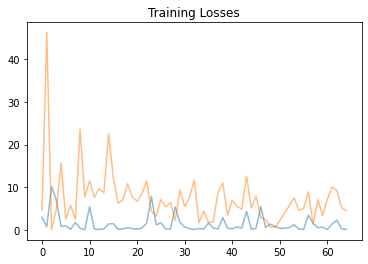

In [20]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.show()

Lets see brain MRIs generated at different epochs while training:

In [21]:
# helper function for viewing a list of passed in sample images
def view_samples(epoch, samples):
    fig, axes = plt.subplots(figsize=(25, 15), nrows=2, ncols=3, sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        img = img.detach().cpu().numpy()
        img = np.transpose(img, (1, 2, 0))
        img = ((img + 1)*255 / (2)).astype(np.uint8)
        ax.xaxis.set_visible(False)
        ax.yaxis.set_visible(False)
        im = ax.imshow(img.reshape((img_size, img_size, 1)), cmap='gray')
        ax.text(4, 10, f'epoch {epoch+1}', fontsize=20, bbox={'facecolor': 'white', 'pad': 10})

In [22]:
# load samples from generator taken at different epochs while training
with open(samples_path, 'rb') as f:
    samples = pkl.load(f)

/home/tufus/miniconda3/envs/gan_ensembles/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


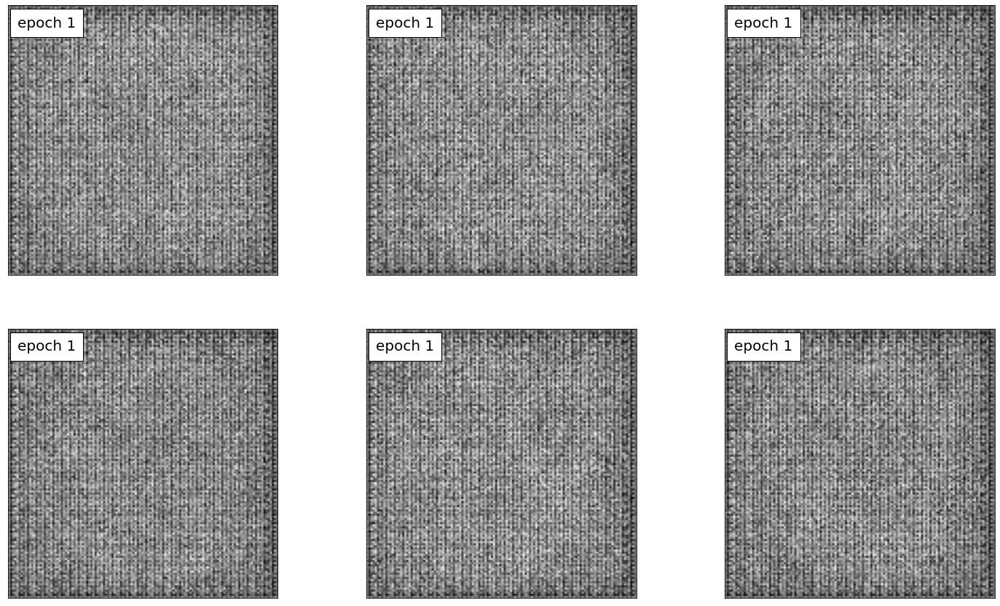

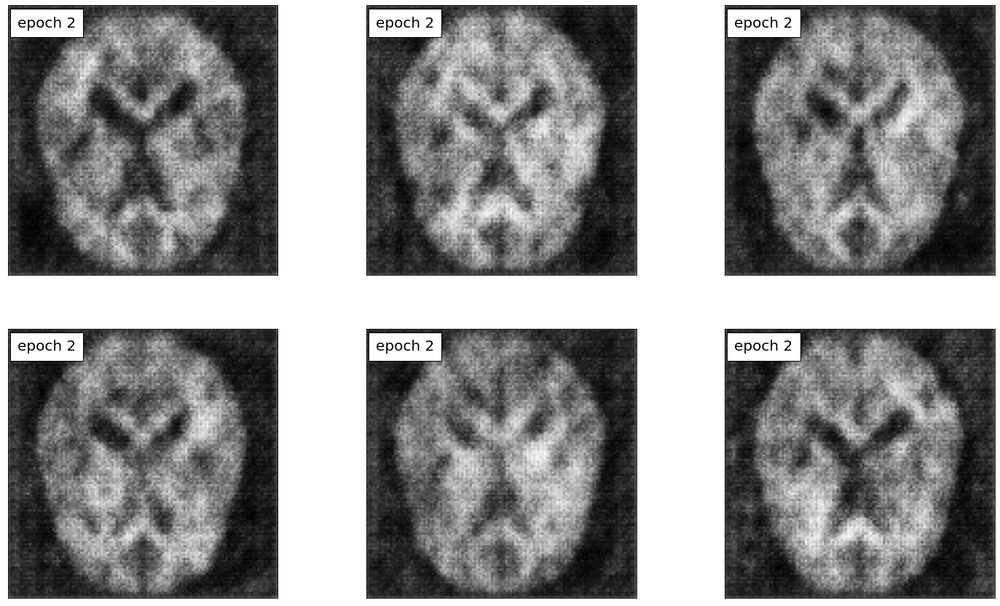

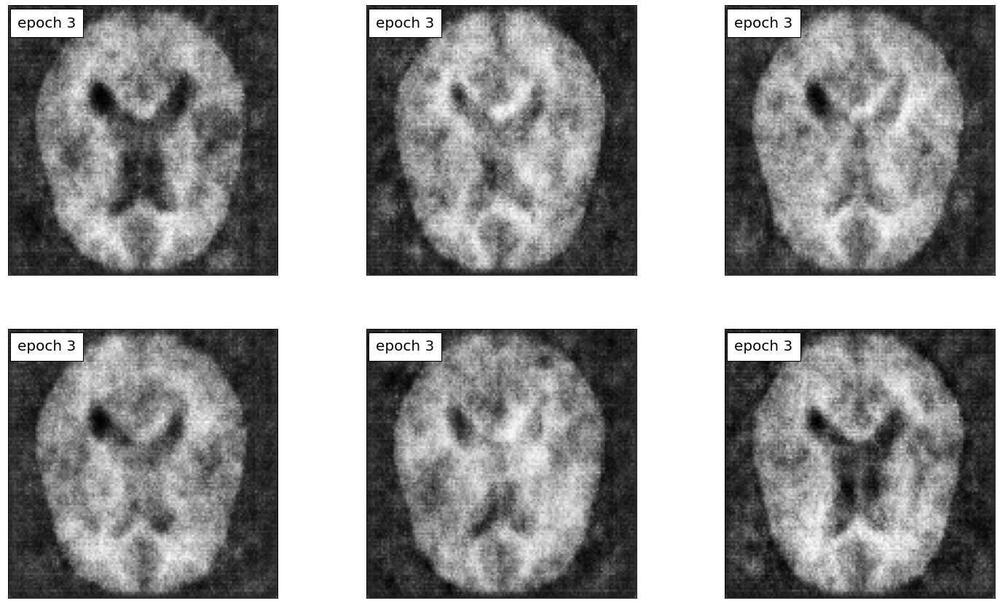

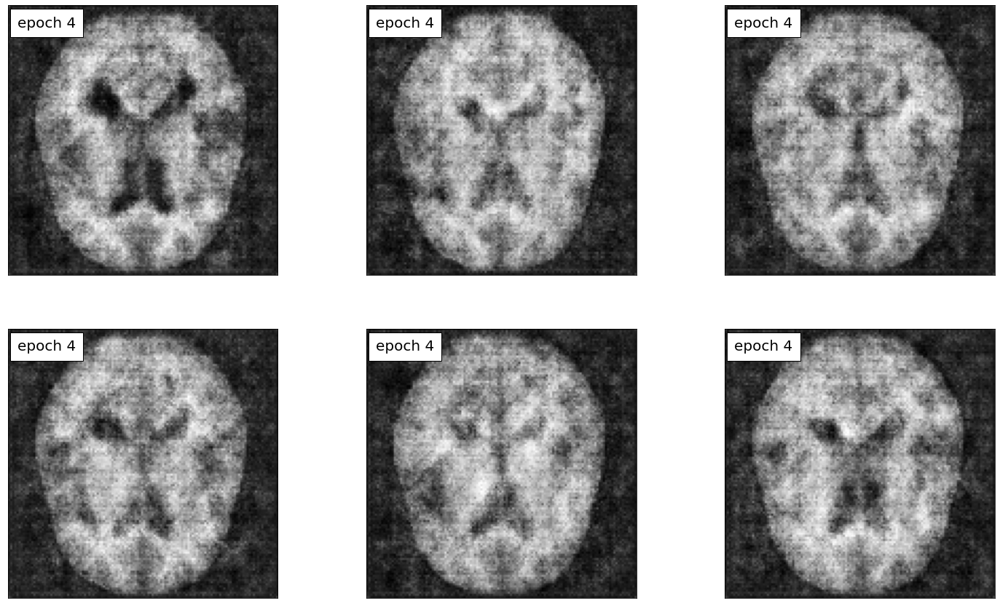

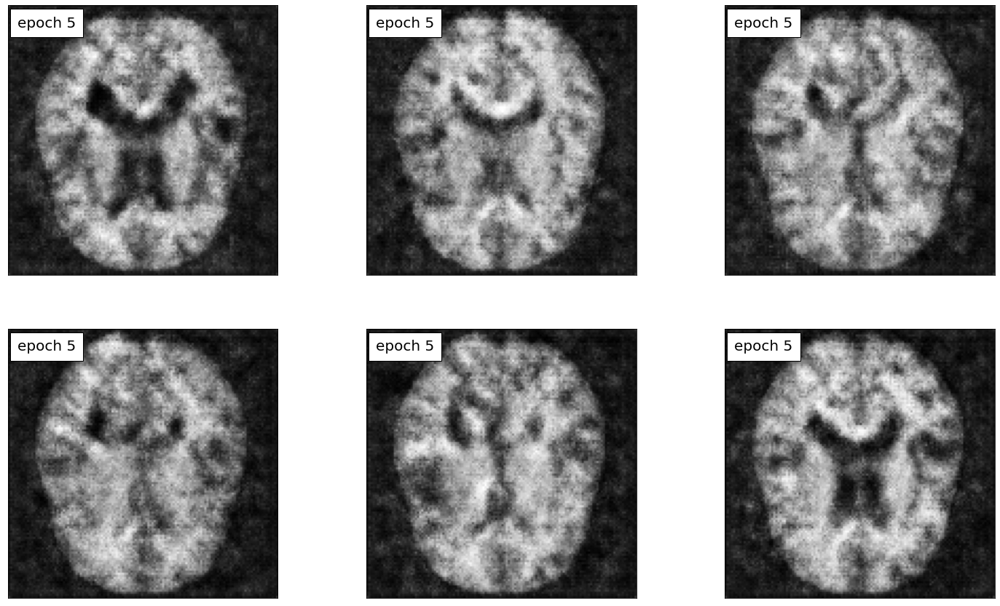

...

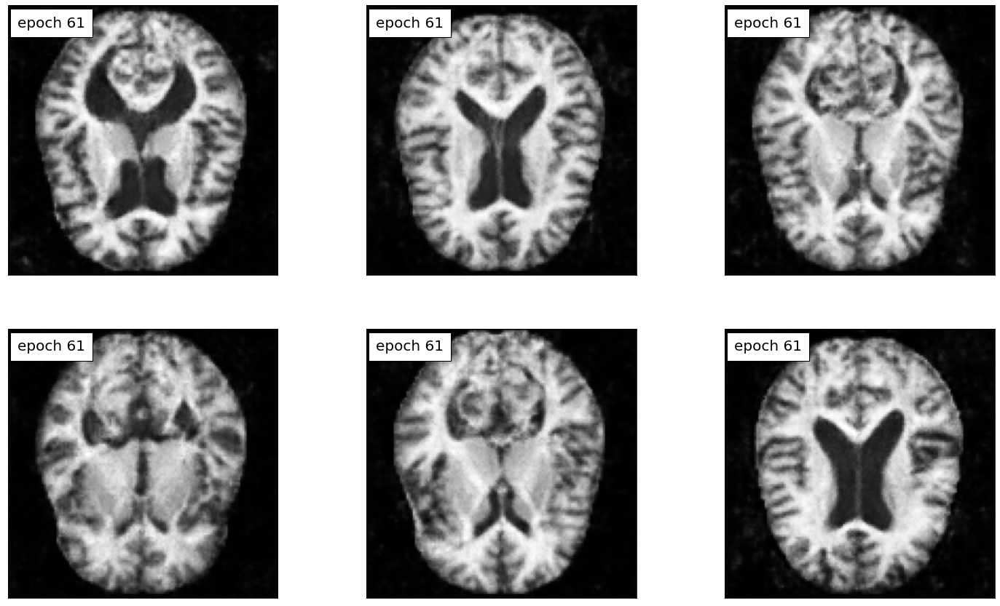

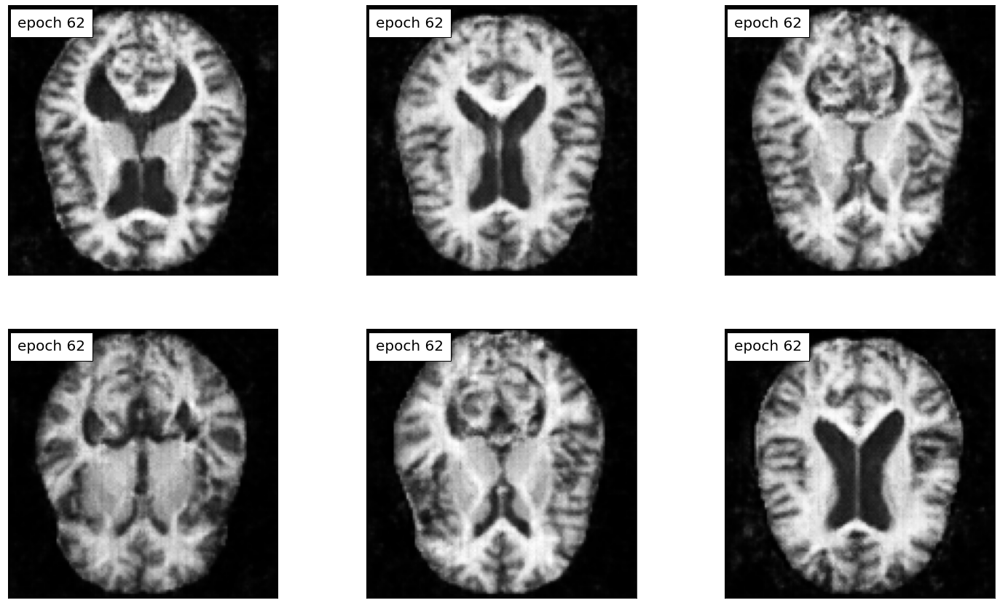

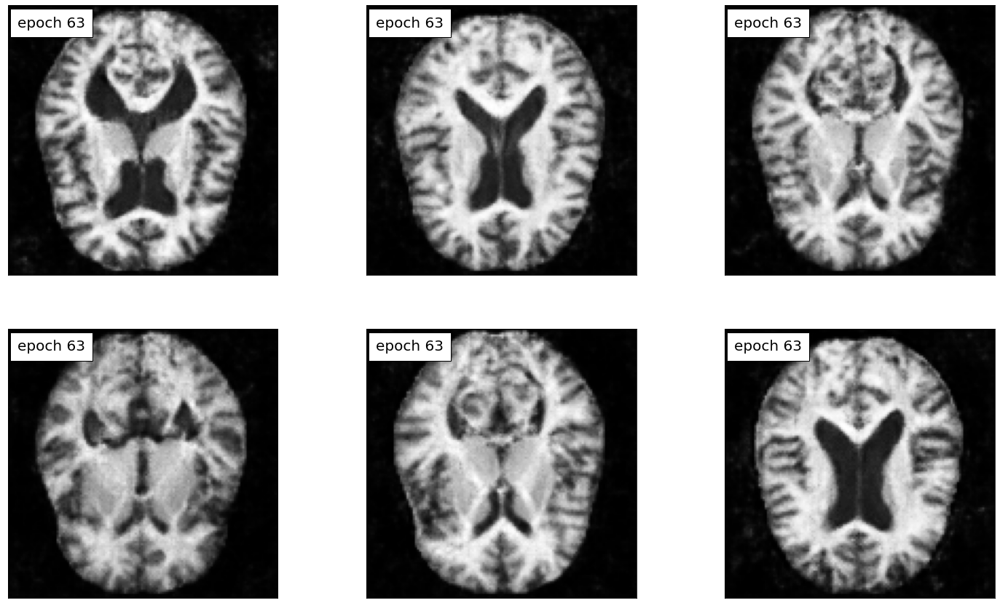

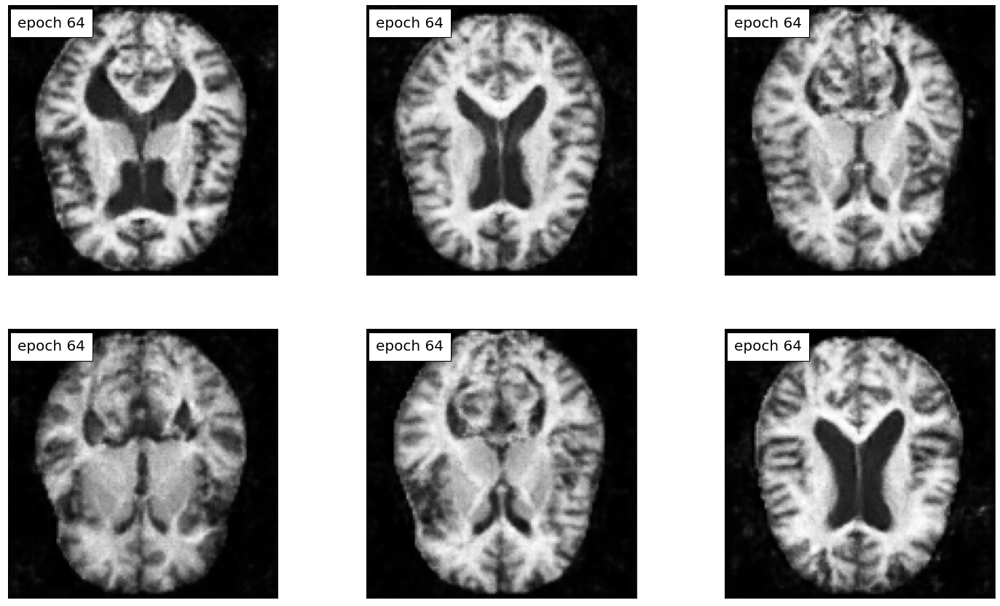

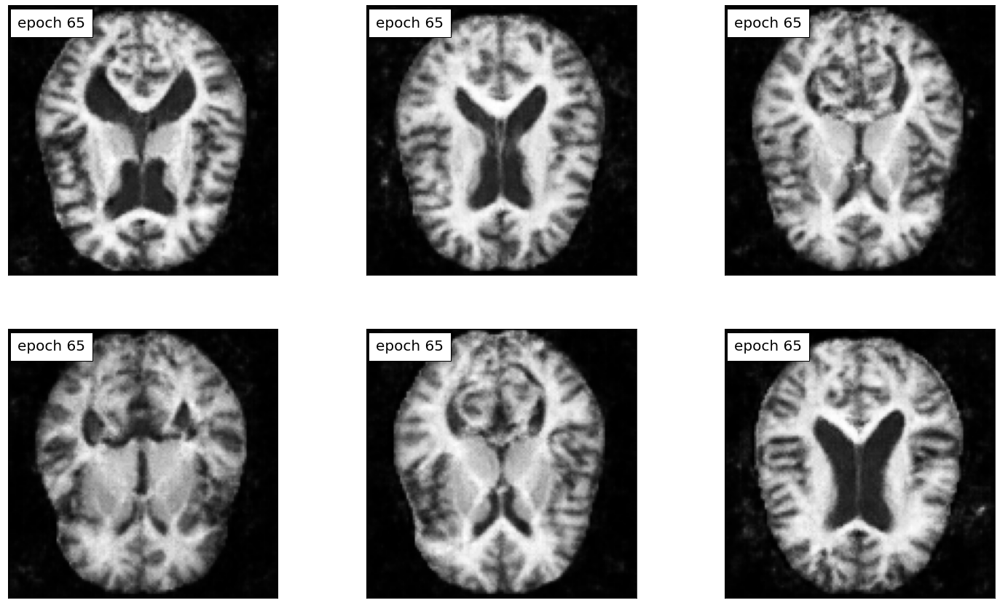

In [23]:
for e in range(0, 65):
    view_samples(e, samples)

At the beginning we can see how the noise becomes more a more like a brain MRI. We can observe that at the last epochs of the training we can generate brain MRIs successfully, with a good quality at least at naked eye. There is no brain matter in black background (gray pixels in black), which is kind of an easy indication in the mid epochs of training. Around epoch 30 to 35 we can see how the images are getting similar, probably reaching some stability and not improving quality around epoch 35, but still varying. We also see the same with the losses, after epoch 35 losses tends to get stable, but still varying. All this is a good indication that we can use model states after epoch 35 for training upcoming ensemble models.

Also notice that at epoch 35 we saved a snapshoot of the generator for future use when comparing results. Lets save the last state of the generator too just in case.

In [24]:
model_path = 'cm/models/cm_final'
torch.save(G.state_dict(), model_path)
print(f' *** model saved {model_path}')

 *** model saved cm/models/cm_final
